<a href="https://colab.research.google.com/github/Anumitha-369/FAKE-FACE-DETECTION-GENAI/blob/main/GenAI_FAKEFACE_DETECTION.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

FAKE FACE DETECTION :

1.collecting the training datset with common samples

2.samples r shared wth discriminator where it will evaluate  
[features will b extracted by discremented ]

3. a noise is sent to generator and the generator will create a sample and share it to the discriminator.

4. now discriminator has old sample which is compared with the
new sample genrator generated .

5. the loss function generated by discriminator which is again sent to the generator to reduce loss and then shared to discriminator for comparison , this is the feedback loop process

6.Thus , image will b seen clearly and we can check whether its fake or real face

Change from CPU to GPU in RAM for effecient epochs and quick response

In [1]:
import tensorflow as tf

import matplotlib.pyplot as plt

import tensorflow as tf

from tensorflow.keras.layers import (

Dense, Conv2D, Conv2DTranspose, Flatten, Reshape,

BatchNormalization, LeakyReLU, Input )

Hyperparameters

In [2]:
BATCH_SIZE = 64
IMG_SIZE = 128
LATENT_DIM = 100
EPOCHS = 400
LR = 2e-4

GENERATOR

In [3]:
def build_generator(latent_dim=100):
    return tf.keras.Sequential([
        Input((latent_dim,)),
        Dense(8*8*512, use_bias=False),
        Reshape((8, 8, 512)),
        Conv2DTranspose(256, 4, 2, "same", use_bias=False),
        BatchNormalization(),
        LeakyReLU(),
        Conv2DTranspose(128, 4, 2, "same", use_bias=False),
        BatchNormalization(),
        LeakyReLU(),
        Conv2DTranspose(64, 4, 2, "same", use_bias=False),
        BatchNormalization(),
        LeakyReLU(),
        Conv2DTranspose(3, 4, 2, "same", activation="tanh")
    ], name="Generator")

Discriminator

In [4]:
def build_discriminator(img_size=128):
    return tf.keras.Sequential([
        Input((img_size, img_size, 3)),
        Conv2D(64, 4, 2, "same"),  LeakyReLU(0.2),
        Conv2D(128, 4, 2, "same"), LeakyReLU(0.2),
        Conv2D(256, 4, 2, "same"), LeakyReLU(0.2),
        Conv2D(512, 4, 2, "same"), LeakyReLU(0.2),
        Flatten(),
        Dense(1)
    ], name="Discriminator")


In [5]:
 # tuple rebounding and use 2 varibles , one for generator and another for discrimator
 G,D = build_generator(), build_discriminator()

generator optimizer technique and discriminator optimizer technique

In [6]:
from tensorflow.keras.losses import BinaryCrossentropy
from keras.optimizers import Adam
loss_fn = BinaryCrossentropy(from_logits=True)
g_opt = Adam(LR, 0.5)
d_opt = Adam(LR, 0.5)

Training step

In [7]:
@tf.function
def train_step(real):
    noise = tf.random.normal([BATCH_SIZE, LATENT_DIM])
    with tf.GradientTape() as g_tape, tf.GradientTape() as d_tape:
        fake = G(noise, training=True)
        r_out, f_out = D(real, training=True), D(fake, training=True)
        g_loss = loss_fn(tf.ones_like(f_out), f_out)
        d_loss = loss_fn(tf.ones_like(r_out), r_out) + loss_fn(tf.zeros_like(f_out), f_out)

    g_opt.apply_gradients(zip(g_tape.gradient(g_loss,
                        G.trainable_variables),
                              G.trainable_variables))
    d_opt.apply_gradients(zip(d_tape.gradient(d_loss, D.trainable_variables),
                              D.trainable_variables))
    return g_loss, d_loss

Show generated images

In [8]:
def show_images(epoch, seed):
    preds = G(seed, training=False)
    preds = (preds + 1) / 2.0   # [-1,1] → [0,1]
    fig, axes = plt.subplots(4,4, figsize=(6,6))
    for i, ax in enumerate(axes.flat):
        ax.imshow(preds[i].numpy())
        ax.axis("off")
    plt.suptitle(f"Epoch {epoch}")
    plt.show()

# 📥 Load dataset (resize to 128x128, normalize to [-1,1])

In [9]:
train_ds = tf.keras.utils.image_dataset_from_directory(
    "/content/drive/MyDrive/FakeFace-main",
    label_mode=None,
    image_size=(IMG_SIZE, IMG_SIZE),
    batch_size=BATCH_SIZE
).map(lambda x: (tf.cast(x, tf.float32) / 127.5) - 1.0).prefetch(tf.data.AUTOTUNE)

Found 297 files.


# 🚀 Training loop

Epoch 1/400 | G: 1.317 D: 0.531
Epoch 2/400 | G: 4.659 D: 0.027
Epoch 3/400 | G: 2.512 D: 0.098
Epoch 4/400 | G: 3.350 D: 0.041
Epoch 5/400 | G: 5.666 D: 0.006


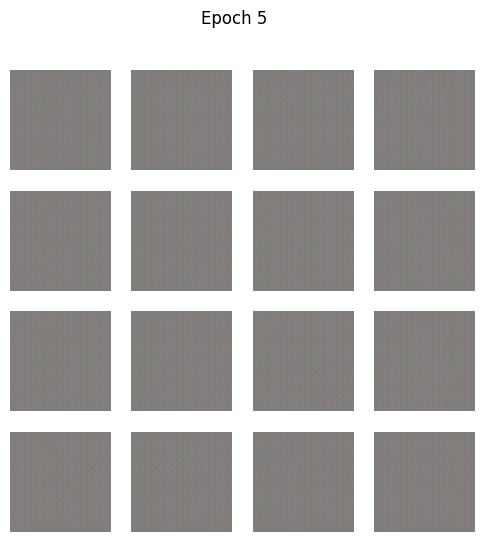

Epoch 6/400 | G: 13.948 D: 0.059
Epoch 7/400 | G: 6.365 D: 0.016
Epoch 8/400 | G: 12.241 D: 0.596
Epoch 9/400 | G: 9.029 D: 0.087
Epoch 10/400 | G: 4.797 D: 0.050


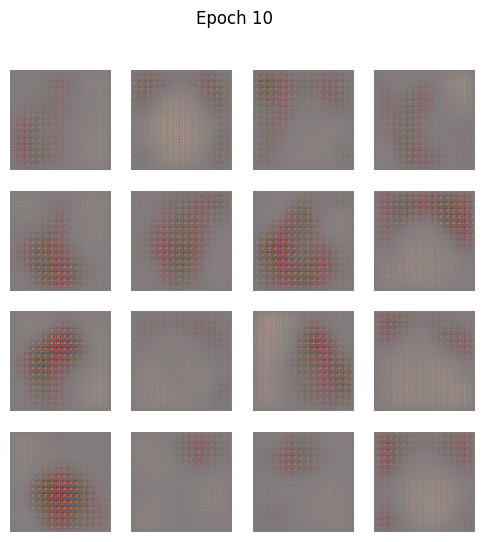

Epoch 11/400 | G: 5.020 D: 0.140
Epoch 12/400 | G: 6.554 D: 0.278
Epoch 13/400 | G: 5.003 D: 0.055
Epoch 14/400 | G: 4.122 D: 0.106
Epoch 15/400 | G: 3.067 D: 0.236


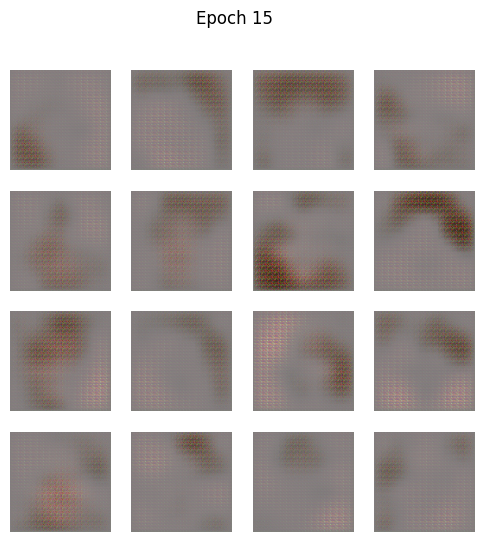

Epoch 16/400 | G: 3.310 D: 0.275
Epoch 17/400 | G: 2.969 D: 0.287
Epoch 18/400 | G: 0.683 D: 1.147
Epoch 19/400 | G: 1.079 D: 0.678
Epoch 20/400 | G: 0.712 D: 0.955


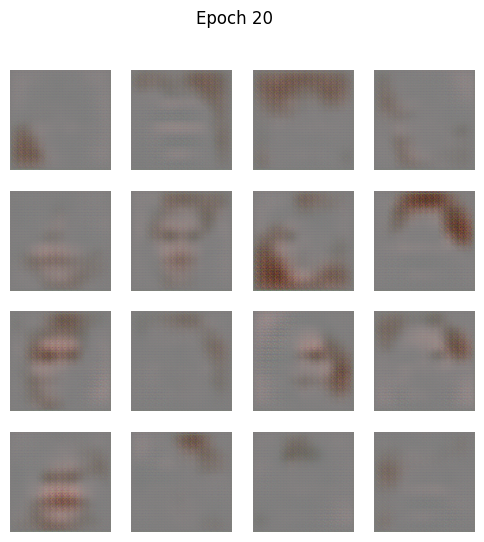

Epoch 21/400 | G: 1.382 D: 0.688
Epoch 22/400 | G: 1.629 D: 0.833
Epoch 23/400 | G: 1.756 D: 0.550
Epoch 24/400 | G: 2.672 D: 1.003
Epoch 25/400 | G: 1.430 D: 0.589


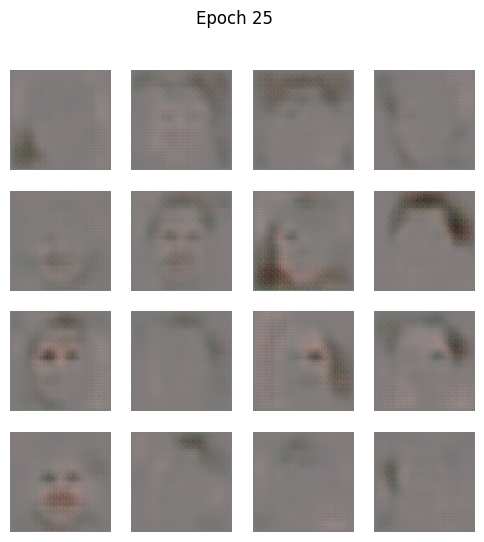

Epoch 26/400 | G: 1.204 D: 0.660
Epoch 27/400 | G: 1.135 D: 0.720
Epoch 28/400 | G: 1.356 D: 0.681
Epoch 29/400 | G: 3.029 D: 0.986
Epoch 30/400 | G: 1.412 D: 0.631


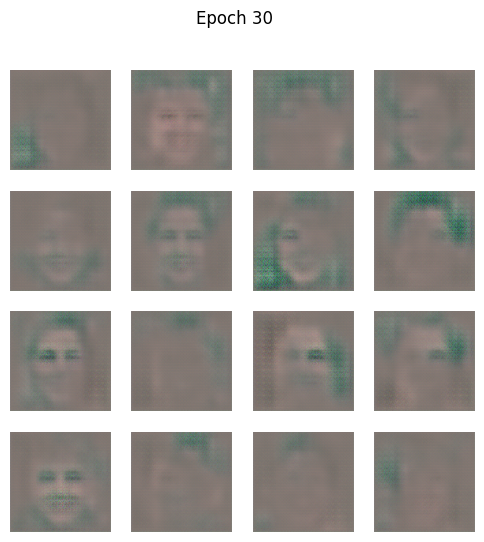

Epoch 31/400 | G: 0.921 D: 0.803
Epoch 32/400 | G: 1.762 D: 0.845
Epoch 33/400 | G: 1.256 D: 0.797
Epoch 34/400 | G: 1.270 D: 0.851
Epoch 35/400 | G: 1.474 D: 0.744


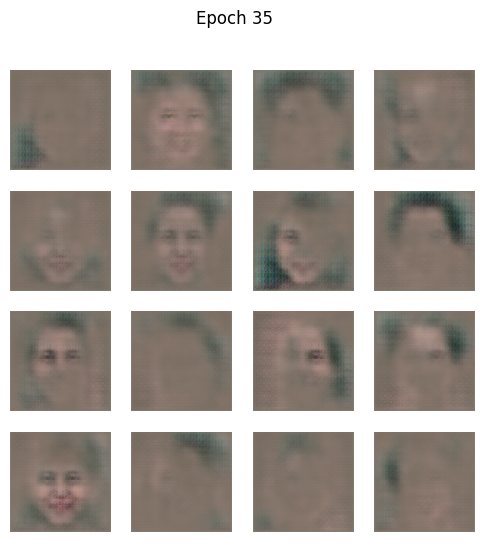

Epoch 36/400 | G: 0.198 D: 2.168
Epoch 37/400 | G: 1.334 D: 1.017
Epoch 38/400 | G: 0.948 D: 1.027
Epoch 39/400 | G: 1.008 D: 1.059
Epoch 40/400 | G: 0.948 D: 1.092


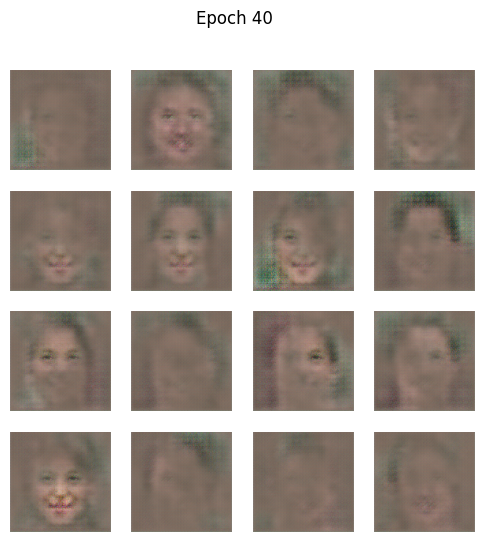

Epoch 41/400 | G: 0.975 D: 1.092
Epoch 42/400 | G: 0.383 D: 1.498
Epoch 43/400 | G: 1.568 D: 1.291
Epoch 44/400 | G: 1.116 D: 1.010
Epoch 45/400 | G: 1.002 D: 0.959


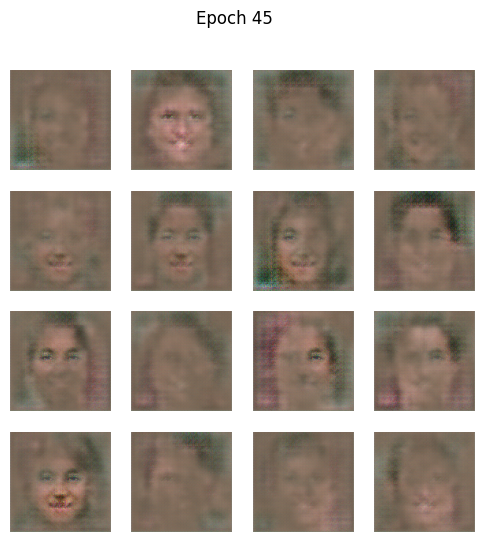

Epoch 46/400 | G: 1.564 D: 1.053
Epoch 47/400 | G: 0.602 D: 1.219
Epoch 48/400 | G: 1.097 D: 1.074
Epoch 49/400 | G: 1.330 D: 0.965
Epoch 50/400 | G: 0.230 D: 1.858


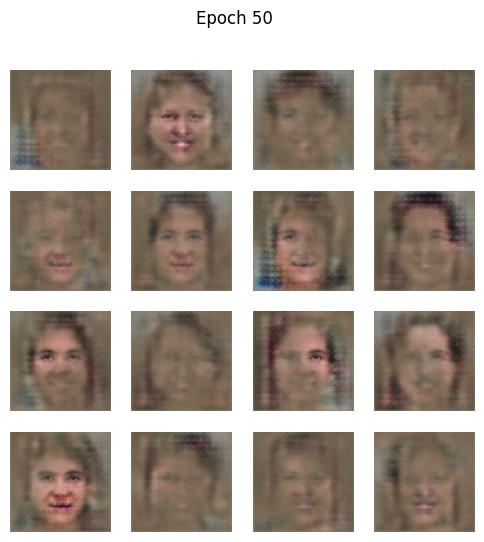

Epoch 51/400 | G: 0.843 D: 1.114
Epoch 52/400 | G: 0.946 D: 0.973
Epoch 53/400 | G: 0.973 D: 1.116
Epoch 54/400 | G: 0.955 D: 1.182
Epoch 55/400 | G: 0.989 D: 0.899


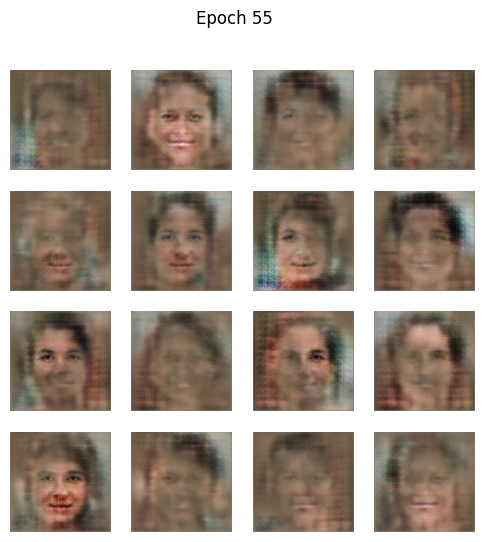

Epoch 56/400 | G: 0.873 D: 1.168
Epoch 57/400 | G: 1.473 D: 1.261
Epoch 58/400 | G: 0.949 D: 1.018
Epoch 59/400 | G: 1.400 D: 1.226
Epoch 60/400 | G: 0.991 D: 1.109


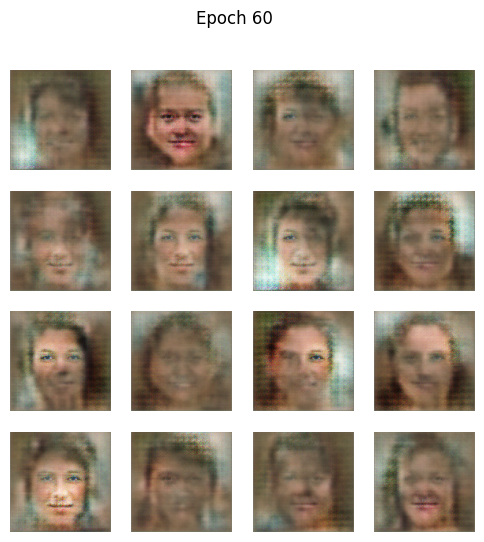

Epoch 61/400 | G: 1.260 D: 1.150
Epoch 62/400 | G: 0.744 D: 1.191
Epoch 63/400 | G: 1.043 D: 0.992
Epoch 64/400 | G: 1.178 D: 0.990
Epoch 65/400 | G: 0.876 D: 1.119


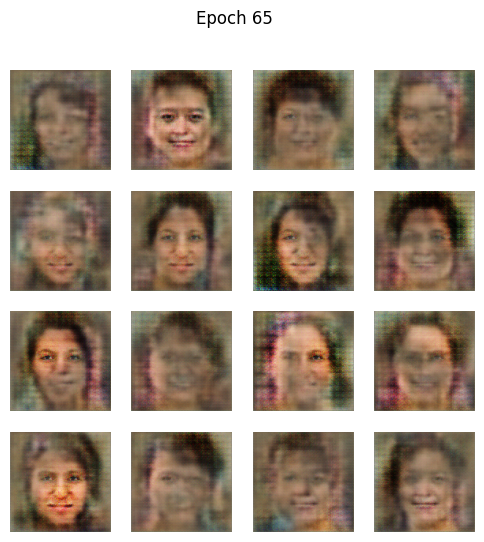

Epoch 66/400 | G: 0.855 D: 1.101
Epoch 67/400 | G: 1.081 D: 0.949
Epoch 68/400 | G: 0.406 D: 1.446
Epoch 69/400 | G: 0.963 D: 1.055
Epoch 70/400 | G: 0.871 D: 1.068


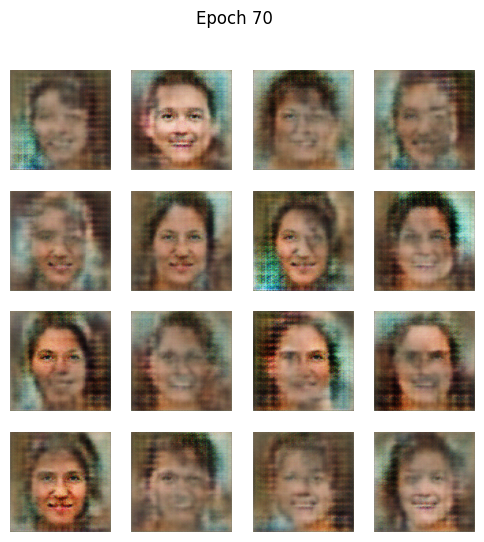

Epoch 71/400 | G: 1.068 D: 1.065
Epoch 72/400 | G: 1.049 D: 1.131
Epoch 73/400 | G: 0.775 D: 1.055
Epoch 74/400 | G: 0.811 D: 1.247
Epoch 75/400 | G: 0.840 D: 1.054


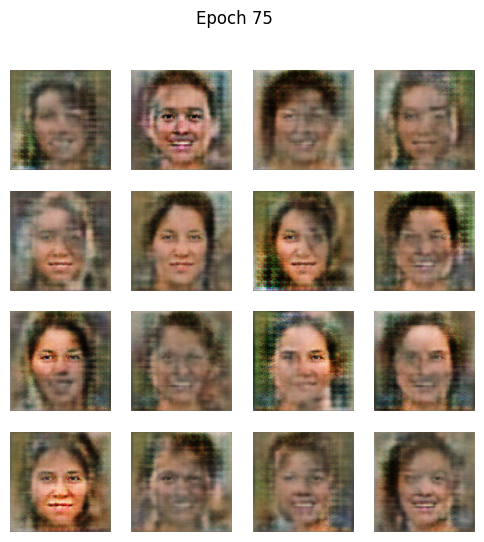

Epoch 76/400 | G: 0.868 D: 1.175
Epoch 77/400 | G: 0.558 D: 1.370
Epoch 78/400 | G: 0.712 D: 1.117
Epoch 79/400 | G: 0.838 D: 1.123
Epoch 80/400 | G: 1.692 D: 1.177


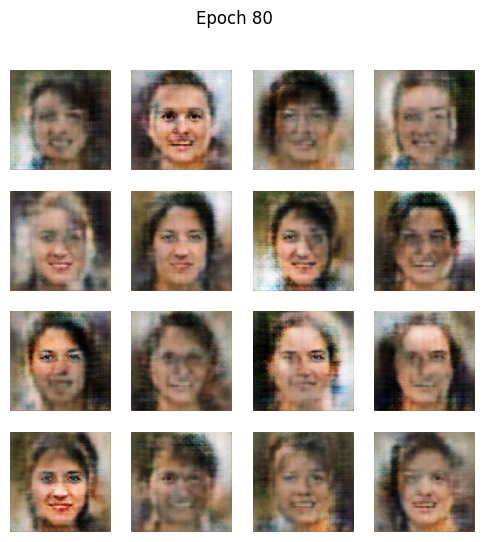

Epoch 81/400 | G: 0.884 D: 1.125
Epoch 82/400 | G: 0.816 D: 1.034
Epoch 83/400 | G: 0.645 D: 1.117
Epoch 84/400 | G: 1.334 D: 1.066
Epoch 85/400 | G: 0.996 D: 1.165


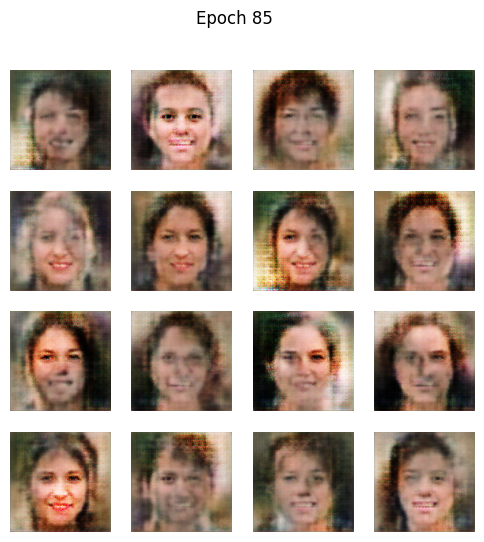

Epoch 86/400 | G: 0.361 D: 1.478
Epoch 87/400 | G: 0.990 D: 0.892
Epoch 88/400 | G: 0.465 D: 1.355
Epoch 89/400 | G: 0.998 D: 1.089
Epoch 90/400 | G: 0.953 D: 0.980


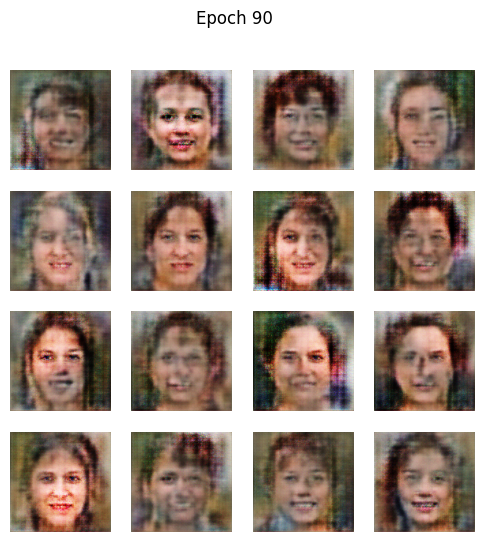

Epoch 91/400 | G: 0.962 D: 1.051
Epoch 92/400 | G: 0.966 D: 1.058
Epoch 93/400 | G: 1.254 D: 0.917
Epoch 94/400 | G: 0.454 D: 1.292
Epoch 95/400 | G: 0.847 D: 1.012


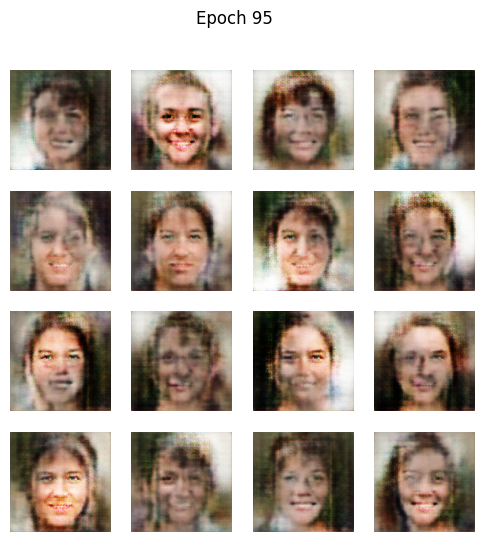

Epoch 96/400 | G: 0.970 D: 1.091
Epoch 97/400 | G: 0.182 D: 1.964
Epoch 98/400 | G: 1.091 D: 1.000
Epoch 99/400 | G: 0.896 D: 0.990
Epoch 100/400 | G: 1.109 D: 0.985


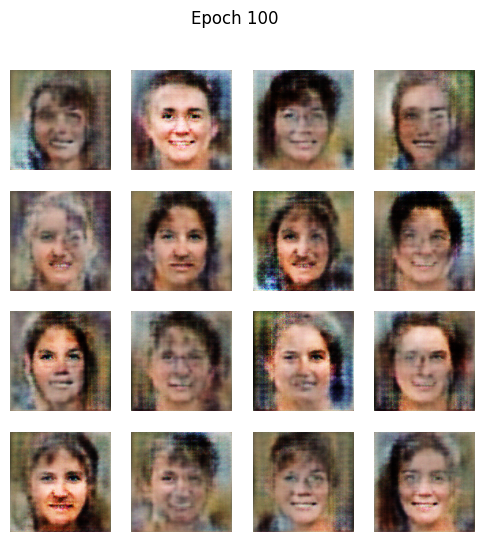

Epoch 101/400 | G: 0.908 D: 0.912
Epoch 102/400 | G: 2.124 D: 1.425
Epoch 103/400 | G: 0.861 D: 1.051
Epoch 104/400 | G: 0.961 D: 0.936
Epoch 105/400 | G: 0.487 D: 1.261


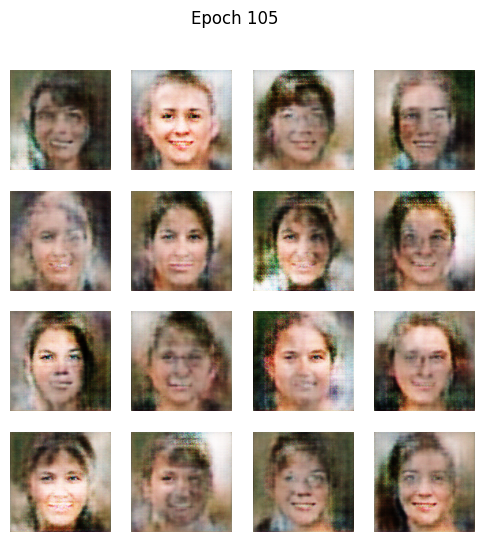

Epoch 106/400 | G: 0.996 D: 0.961
Epoch 107/400 | G: 1.076 D: 0.966
Epoch 108/400 | G: 1.068 D: 0.963
Epoch 109/400 | G: 1.085 D: 0.926
Epoch 110/400 | G: 0.630 D: 1.152


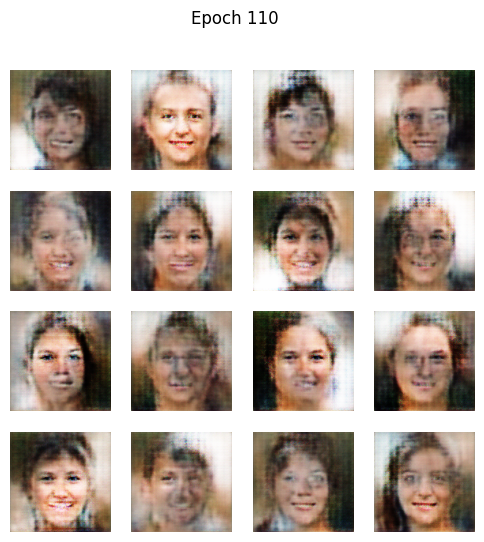

Epoch 111/400 | G: 1.057 D: 0.890
Epoch 112/400 | G: 1.141 D: 0.830
Epoch 113/400 | G: 1.166 D: 0.779
Epoch 114/400 | G: 0.273 D: 1.699
Epoch 115/400 | G: 1.075 D: 0.848


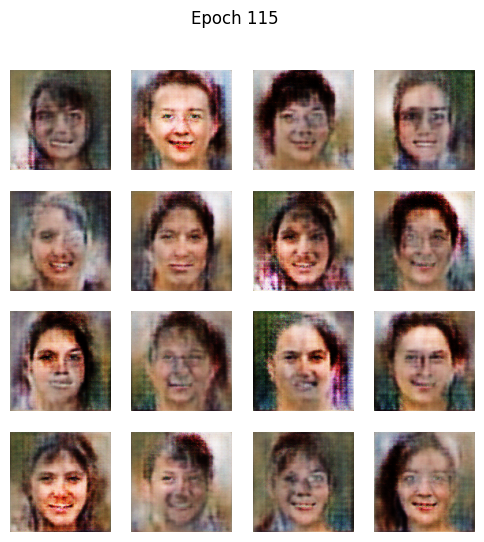

Epoch 116/400 | G: 1.068 D: 0.867
Epoch 117/400 | G: 2.062 D: 1.111
Epoch 118/400 | G: 1.169 D: 0.878
Epoch 119/400 | G: 1.096 D: 0.893
Epoch 120/400 | G: 0.906 D: 0.740


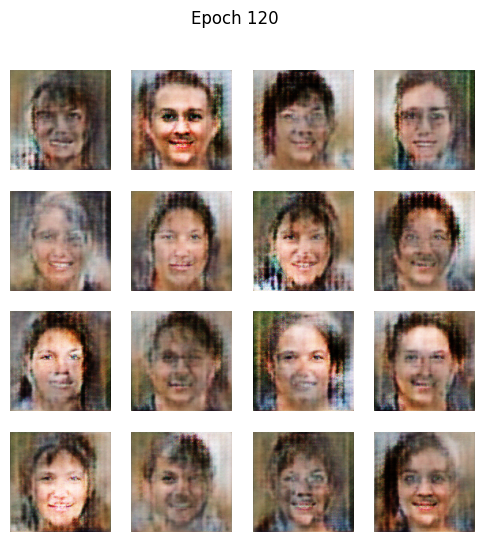

Epoch 121/400 | G: 1.967 D: 1.247
Epoch 122/400 | G: 1.547 D: 0.798
Epoch 123/400 | G: 1.237 D: 0.743
Epoch 124/400 | G: 1.573 D: 0.881
Epoch 125/400 | G: 1.011 D: 0.884


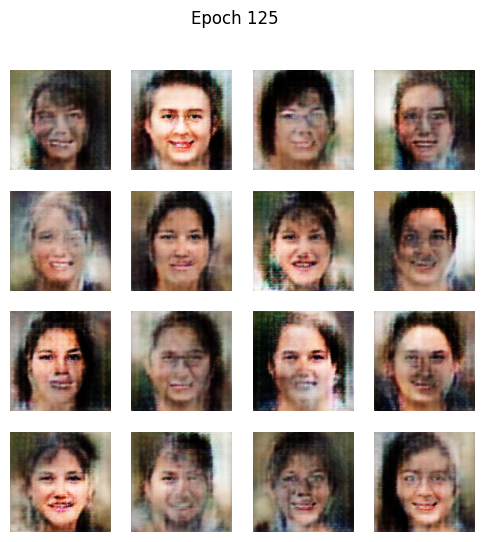

Epoch 126/400 | G: 0.974 D: 0.882
Epoch 127/400 | G: 1.057 D: 0.915
Epoch 128/400 | G: 1.174 D: 0.817
Epoch 129/400 | G: 0.668 D: 1.129
Epoch 130/400 | G: 1.214 D: 0.803


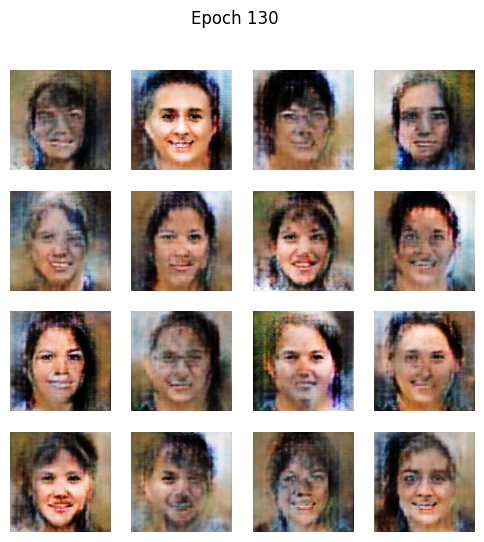

Epoch 131/400 | G: 0.925 D: 0.979
Epoch 132/400 | G: 1.413 D: 0.735
Epoch 133/400 | G: 1.186 D: 0.739
Epoch 134/400 | G: 1.059 D: 0.807
Epoch 135/400 | G: 1.237 D: 0.787


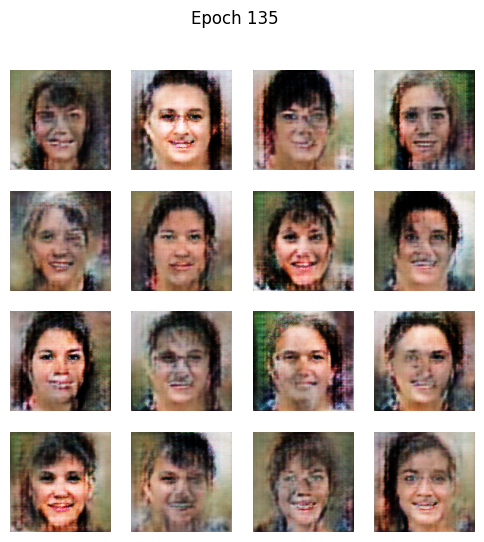

Epoch 136/400 | G: 0.279 D: 1.672
Epoch 137/400 | G: 0.929 D: 0.798
Epoch 138/400 | G: 0.707 D: 1.093
Epoch 139/400 | G: 1.474 D: 0.797
Epoch 140/400 | G: 1.572 D: 0.724


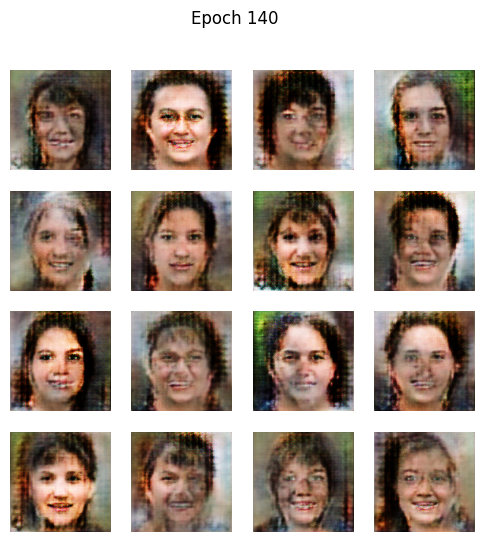

Epoch 141/400 | G: 1.969 D: 1.351
Epoch 142/400 | G: 0.960 D: 1.111
Epoch 143/400 | G: 1.068 D: 0.938
Epoch 144/400 | G: 1.035 D: 1.096
Epoch 145/400 | G: 1.017 D: 0.959


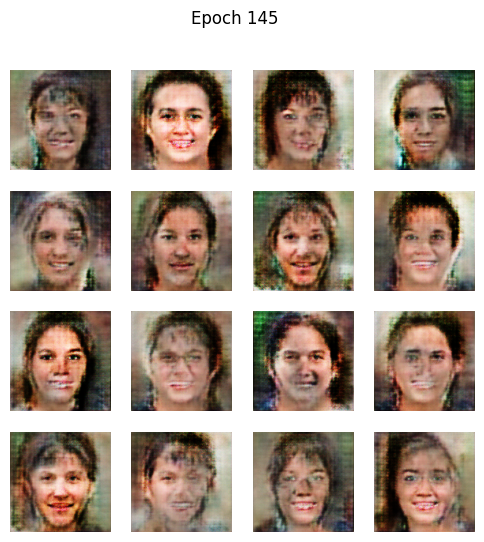

Epoch 146/400 | G: 0.952 D: 0.865
Epoch 147/400 | G: 1.559 D: 0.817
Epoch 148/400 | G: 1.148 D: 0.859
Epoch 149/400 | G: 0.248 D: 1.769
Epoch 150/400 | G: 1.322 D: 0.838


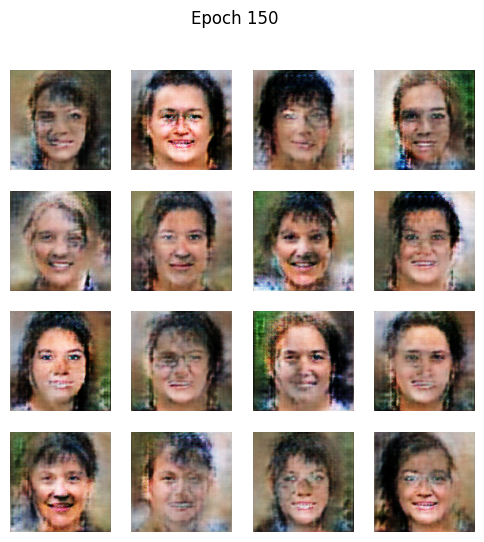

Epoch 151/400 | G: 1.346 D: 0.847
Epoch 152/400 | G: 1.024 D: 0.893
Epoch 153/400 | G: 0.799 D: 0.952
Epoch 154/400 | G: 1.590 D: 0.888
Epoch 155/400 | G: 0.923 D: 0.872


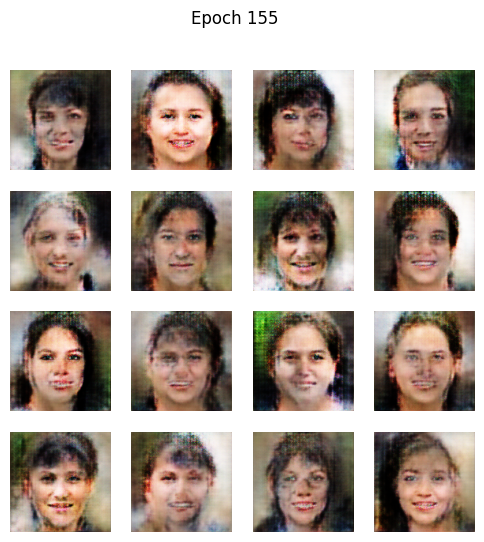

Epoch 156/400 | G: 0.794 D: 0.979
Epoch 157/400 | G: 2.003 D: 0.816
Epoch 158/400 | G: 1.487 D: 0.684
Epoch 159/400 | G: 1.247 D: 0.785
Epoch 160/400 | G: 1.151 D: 0.876


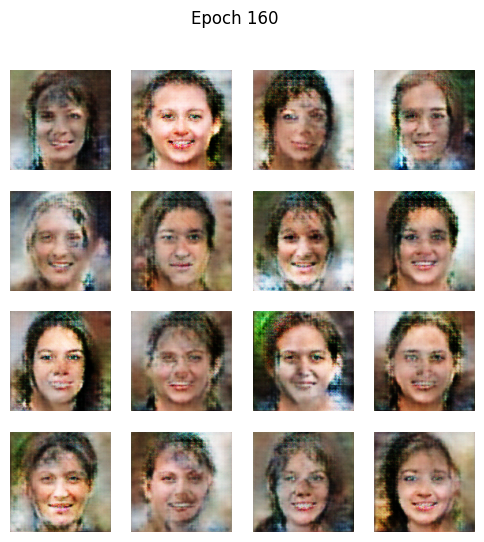

Epoch 161/400 | G: 0.677 D: 0.972
Epoch 162/400 | G: 1.167 D: 1.062
Epoch 163/400 | G: 1.749 D: 0.918
Epoch 164/400 | G: 1.567 D: 0.909
Epoch 165/400 | G: 1.137 D: 0.787


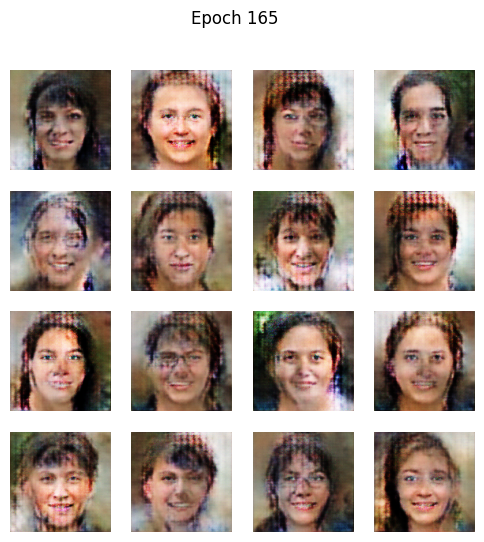

Epoch 166/400 | G: 1.539 D: 0.845
Epoch 167/400 | G: 0.795 D: 0.965
Epoch 168/400 | G: 1.714 D: 1.076
Epoch 169/400 | G: 1.629 D: 0.986
Epoch 170/400 | G: 0.863 D: 0.886


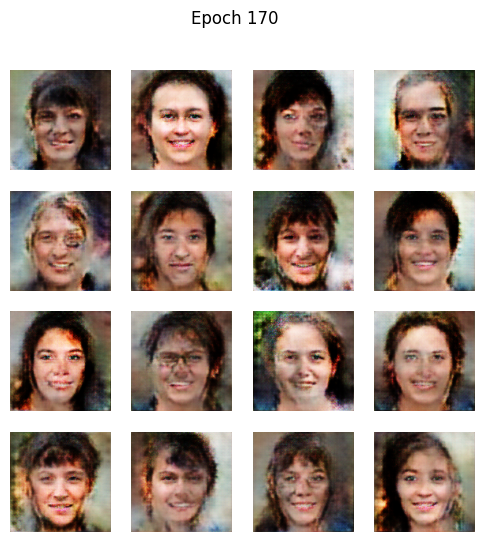

Epoch 171/400 | G: 1.098 D: 0.849
Epoch 172/400 | G: 2.703 D: 1.231
Epoch 173/400 | G: 2.402 D: 1.612
Epoch 174/400 | G: 0.954 D: 0.893
Epoch 175/400 | G: 0.964 D: 0.856


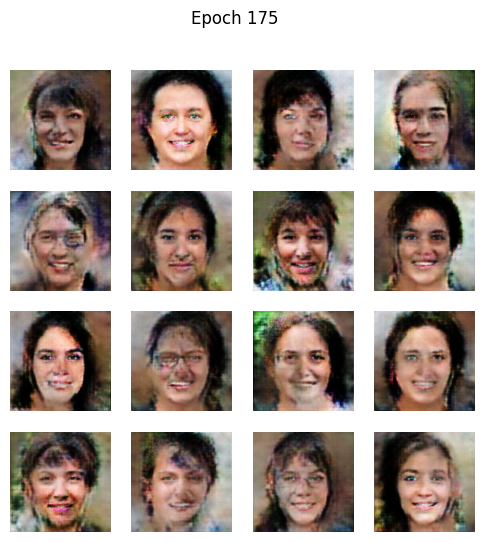

Epoch 176/400 | G: 1.652 D: 0.770
Epoch 177/400 | G: 0.685 D: 1.055
Epoch 178/400 | G: 1.008 D: 0.856
Epoch 179/400 | G: 1.053 D: 0.812
Epoch 180/400 | G: 1.390 D: 0.733


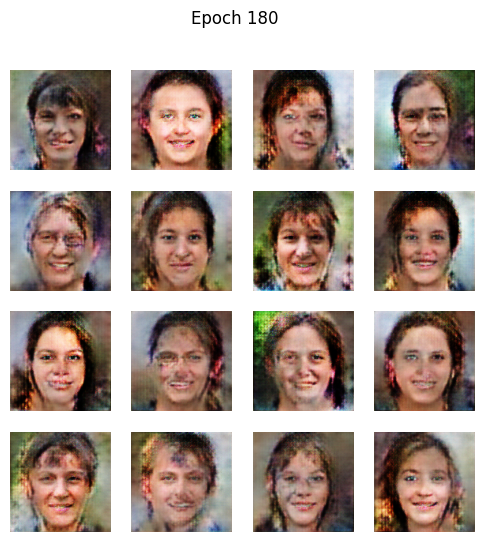

Epoch 181/400 | G: 0.455 D: 1.292
Epoch 182/400 | G: 0.808 D: 0.927
Epoch 183/400 | G: 0.756 D: 0.930
Epoch 184/400 | G: 1.013 D: 0.826
Epoch 185/400 | G: 0.915 D: 0.844


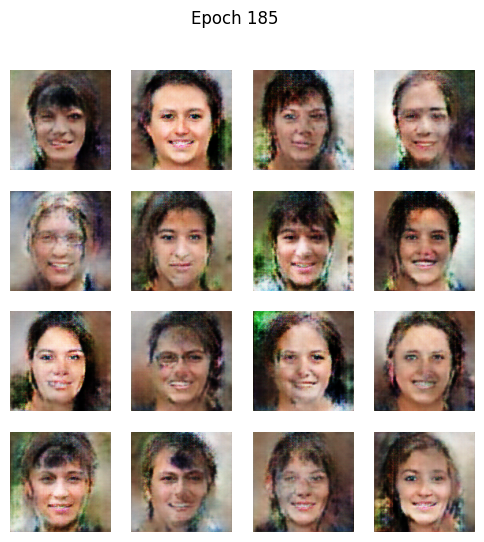

Epoch 186/400 | G: 1.300 D: 0.703
Epoch 187/400 | G: 4.046 D: 2.134
Epoch 188/400 | G: 0.962 D: 1.262
Epoch 189/400 | G: 0.973 D: 0.954
Epoch 190/400 | G: 1.008 D: 0.931


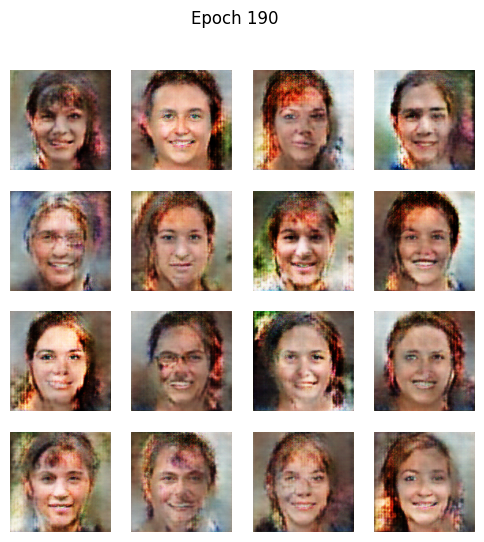

Epoch 191/400 | G: 1.286 D: 0.933
Epoch 192/400 | G: 0.715 D: 1.065
Epoch 193/400 | G: 1.082 D: 0.826
Epoch 194/400 | G: 1.246 D: 0.613
Epoch 195/400 | G: 1.779 D: 1.047


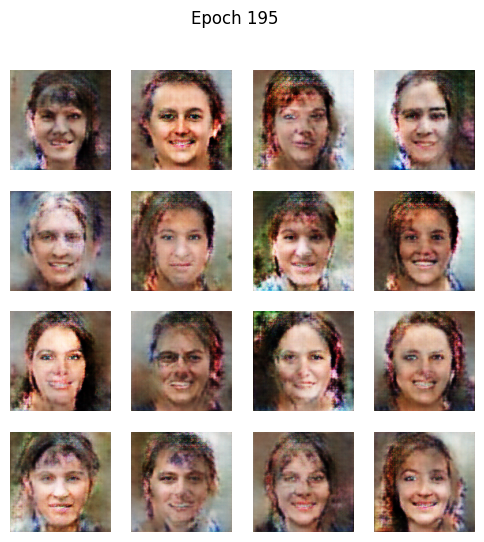

Epoch 196/400 | G: 0.883 D: 0.876
Epoch 197/400 | G: 2.059 D: 0.861
Epoch 198/400 | G: 1.451 D: 0.846
Epoch 199/400 | G: 0.617 D: 1.146
Epoch 200/400 | G: 1.176 D: 0.868


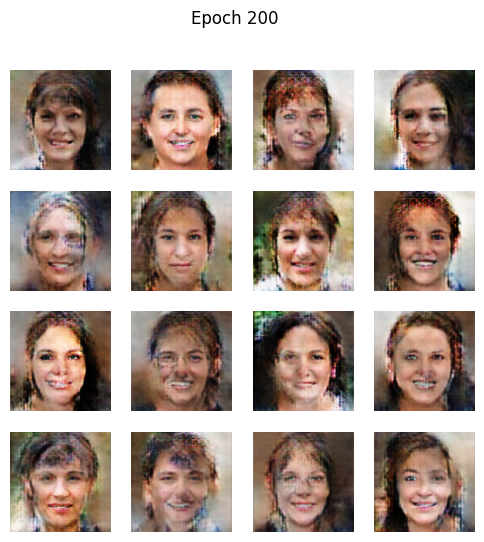

Epoch 201/400 | G: 1.058 D: 0.816
Epoch 202/400 | G: 0.714 D: 0.960
Epoch 203/400 | G: 1.397 D: 0.974
Epoch 204/400 | G: 1.365 D: 0.801
Epoch 205/400 | G: 1.426 D: 0.902


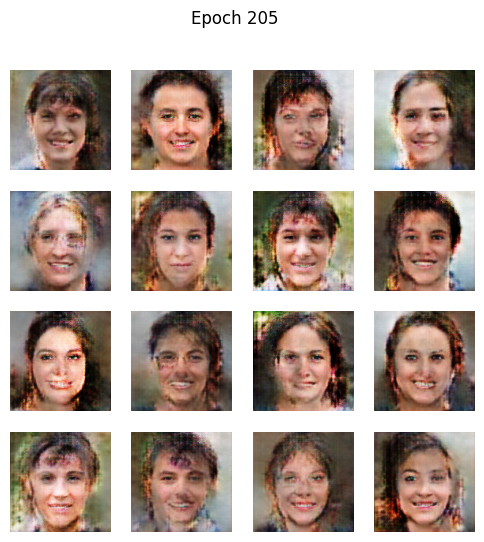

Epoch 206/400 | G: 1.486 D: 0.753
Epoch 207/400 | G: 1.186 D: 0.931
Epoch 208/400 | G: 2.400 D: 1.157
Epoch 209/400 | G: 1.180 D: 0.727
Epoch 210/400 | G: 1.006 D: 0.766


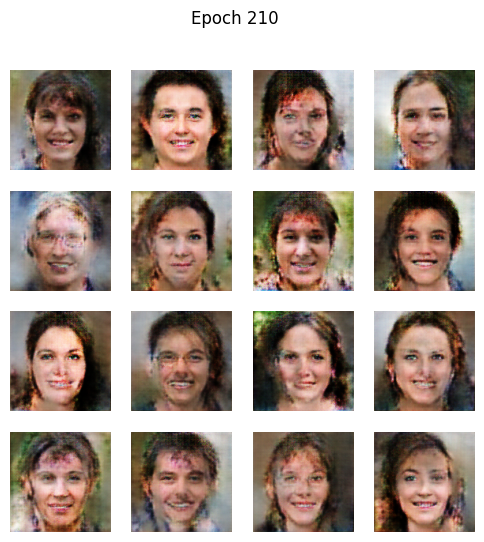

Epoch 211/400 | G: 3.043 D: 1.485
Epoch 212/400 | G: 1.134 D: 0.775
Epoch 213/400 | G: 1.522 D: 0.679
Epoch 214/400 | G: 1.022 D: 0.721
Epoch 215/400 | G: 1.494 D: 0.848


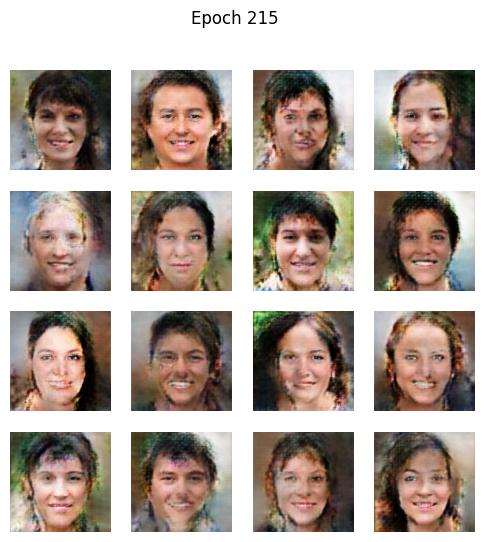

Epoch 216/400 | G: 1.314 D: 0.628
Epoch 217/400 | G: 1.553 D: 0.574
Epoch 218/400 | G: 3.062 D: 1.272
Epoch 219/400 | G: 1.516 D: 0.814
Epoch 220/400 | G: 1.663 D: 0.790


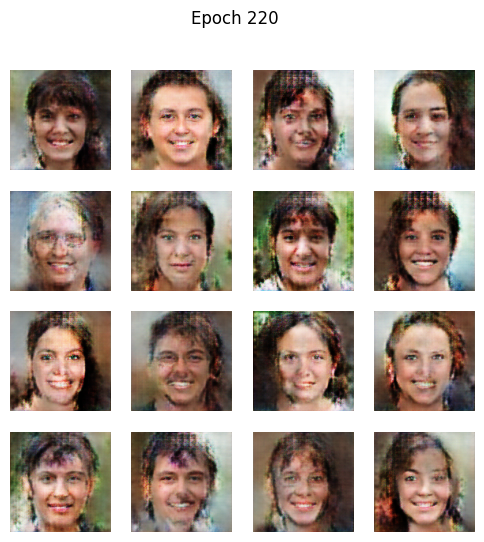

Epoch 221/400 | G: 1.827 D: 0.916
Epoch 222/400 | G: 1.606 D: 0.804
Epoch 223/400 | G: 1.822 D: 0.911
Epoch 224/400 | G: 1.134 D: 0.777
Epoch 225/400 | G: 1.546 D: 0.891


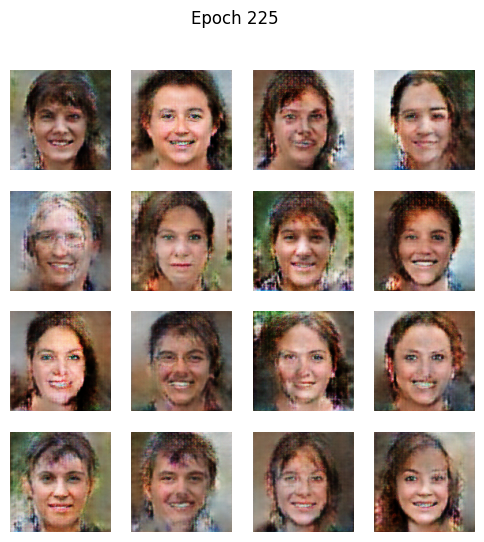

Epoch 226/400 | G: 0.768 D: 0.920
Epoch 227/400 | G: 1.500 D: 0.651
Epoch 228/400 | G: 0.845 D: 0.774
Epoch 229/400 | G: 1.678 D: 0.708
Epoch 230/400 | G: 1.398 D: 0.732


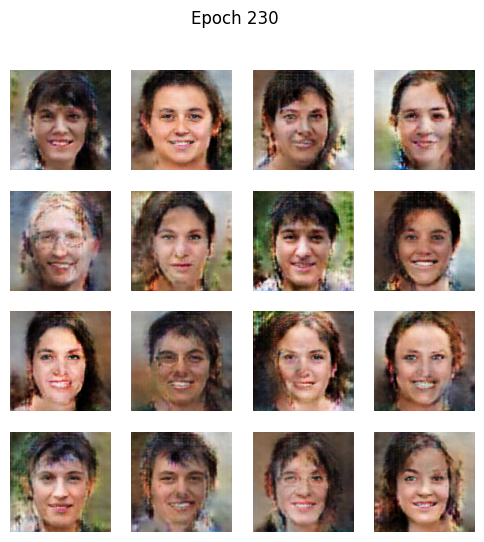

Epoch 231/400 | G: 1.360 D: 0.832
Epoch 232/400 | G: 2.881 D: 0.995
Epoch 233/400 | G: 1.394 D: 0.821
Epoch 234/400 | G: 0.726 D: 0.881
Epoch 235/400 | G: 1.393 D: 0.757


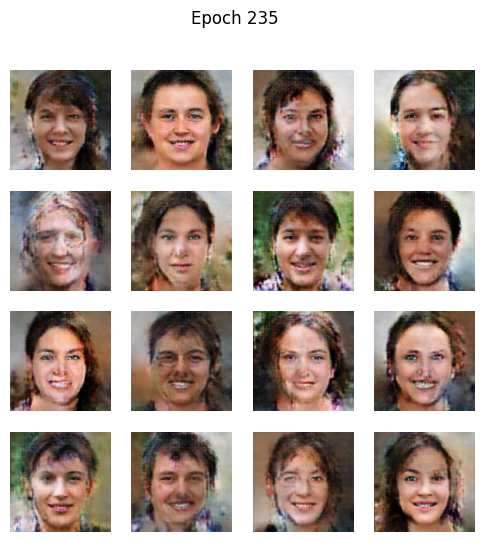

Epoch 236/400 | G: 0.802 D: 0.858
Epoch 237/400 | G: 1.163 D: 0.809
Epoch 238/400 | G: 0.870 D: 0.804
Epoch 239/400 | G: 0.994 D: 0.670
Epoch 240/400 | G: 1.531 D: 0.730


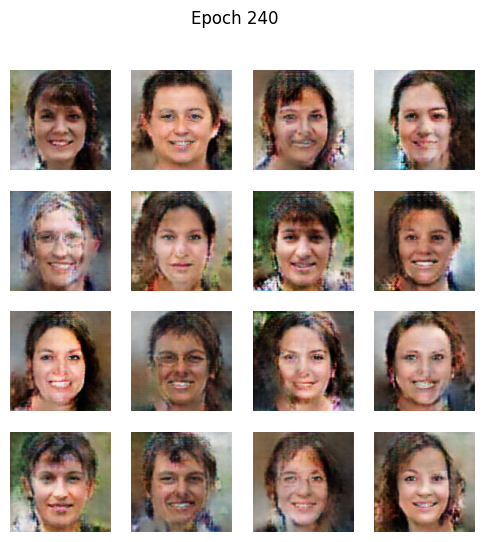

Epoch 241/400 | G: 0.925 D: 0.753
Epoch 242/400 | G: 1.387 D: 0.694
Epoch 243/400 | G: 0.777 D: 0.815
Epoch 244/400 | G: 0.521 D: 1.293
Epoch 245/400 | G: 2.456 D: 0.590


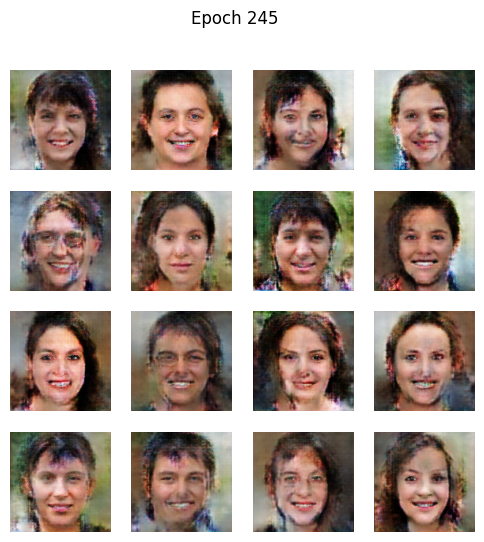

Epoch 246/400 | G: 1.376 D: 0.674
Epoch 247/400 | G: 1.185 D: 0.713
Epoch 248/400 | G: 0.563 D: 1.259
Epoch 249/400 | G: 1.045 D: 0.696
Epoch 250/400 | G: 1.328 D: 0.735


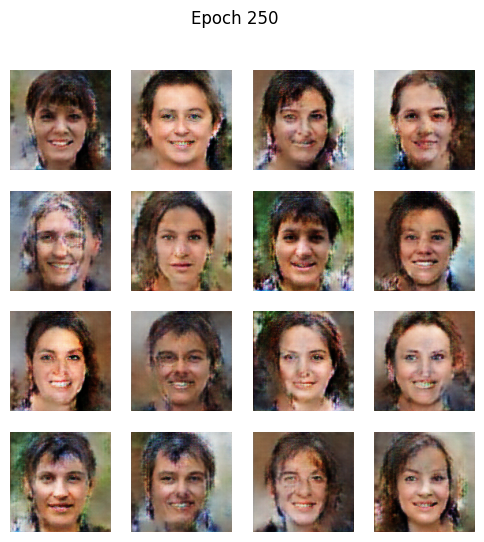

Epoch 251/400 | G: 0.971 D: 0.715
Epoch 252/400 | G: 1.513 D: 0.707
Epoch 253/400 | G: 1.350 D: 0.713
Epoch 254/400 | G: 0.654 D: 1.004
Epoch 255/400 | G: 1.092 D: 0.728


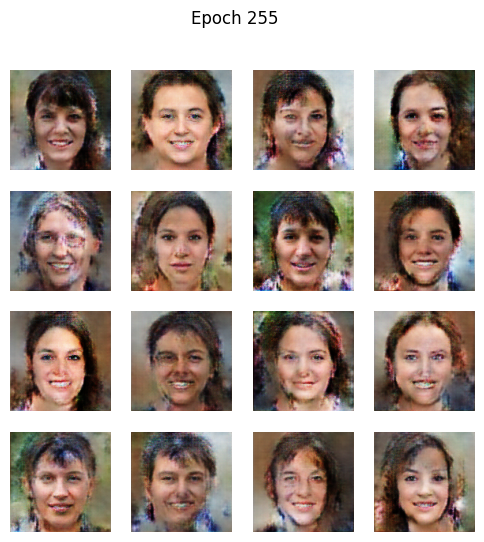

Epoch 256/400 | G: 1.092 D: 0.821
Epoch 257/400 | G: 1.871 D: 0.637
Epoch 258/400 | G: 1.472 D: 0.706
Epoch 259/400 | G: 1.174 D: 0.562
Epoch 260/400 | G: 0.989 D: 0.734


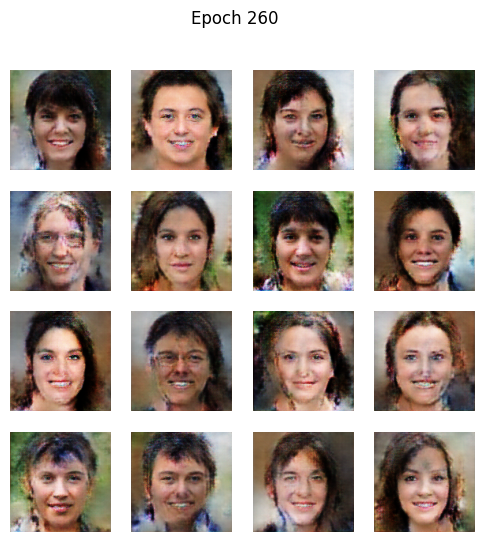

Epoch 261/400 | G: 0.976 D: 0.941
Epoch 262/400 | G: 1.180 D: 0.793
Epoch 263/400 | G: 0.934 D: 0.824
Epoch 264/400 | G: 1.691 D: 0.615
Epoch 265/400 | G: 1.594 D: 0.844


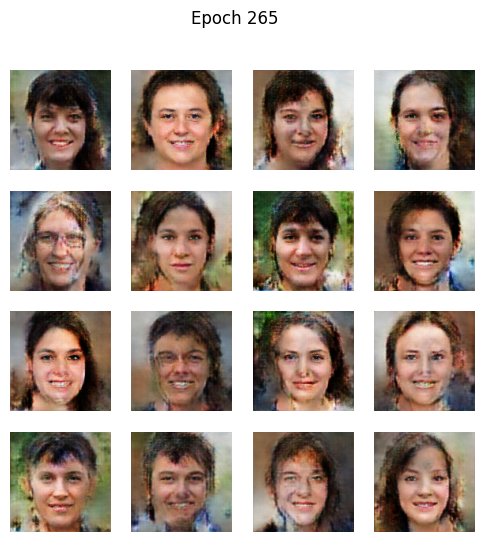

Epoch 266/400 | G: 0.739 D: 0.938
Epoch 267/400 | G: 1.102 D: 0.683
Epoch 268/400 | G: 1.650 D: 0.738
Epoch 269/400 | G: 0.776 D: 0.794
Epoch 270/400 | G: 0.678 D: 0.939


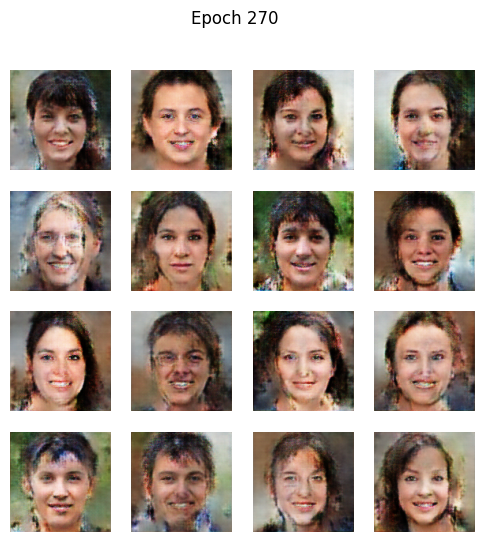

Epoch 271/400 | G: 1.185 D: 0.597
Epoch 272/400 | G: 1.399 D: 0.687
Epoch 273/400 | G: 1.139 D: 0.620
Epoch 274/400 | G: 0.714 D: 0.869
Epoch 275/400 | G: 0.533 D: 1.154


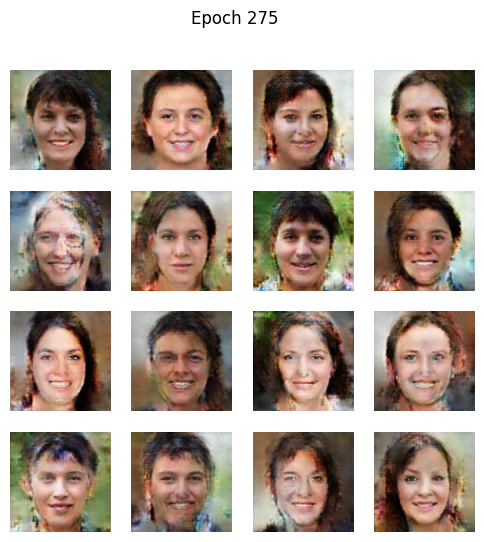

Epoch 276/400 | G: 1.248 D: 0.745
Epoch 277/400 | G: 1.672 D: 0.521
Epoch 278/400 | G: 2.470 D: 0.664
Epoch 279/400 | G: 2.031 D: 0.540
Epoch 280/400 | G: 2.101 D: 0.537


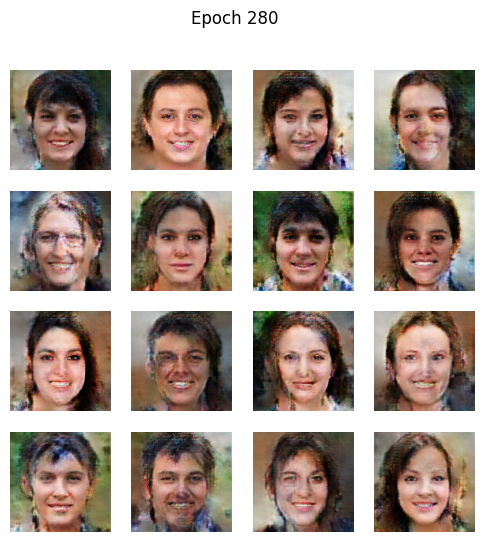

Epoch 281/400 | G: 0.779 D: 0.845
Epoch 282/400 | G: 0.897 D: 0.782
Epoch 283/400 | G: 1.852 D: 0.617
Epoch 284/400 | G: 2.316 D: 0.597
Epoch 285/400 | G: 2.651 D: 0.793


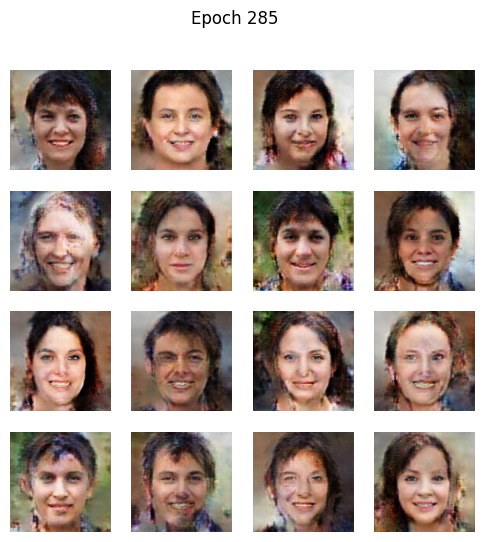

Epoch 286/400 | G: 1.561 D: 0.546
Epoch 287/400 | G: 2.242 D: 0.546
Epoch 288/400 | G: 2.110 D: 0.581
Epoch 289/400 | G: 1.848 D: 0.442
Epoch 290/400 | G: 1.849 D: 0.492


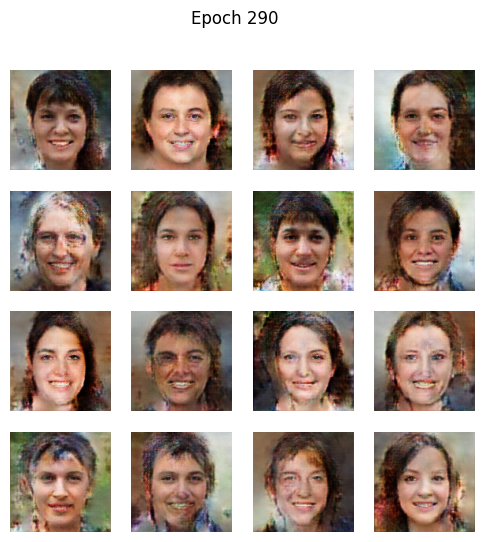

Epoch 291/400 | G: 1.738 D: 0.545
Epoch 292/400 | G: 2.240 D: 0.484
Epoch 293/400 | G: 1.625 D: 0.518
Epoch 294/400 | G: 3.591 D: 1.155
Epoch 295/400 | G: 1.971 D: 0.721


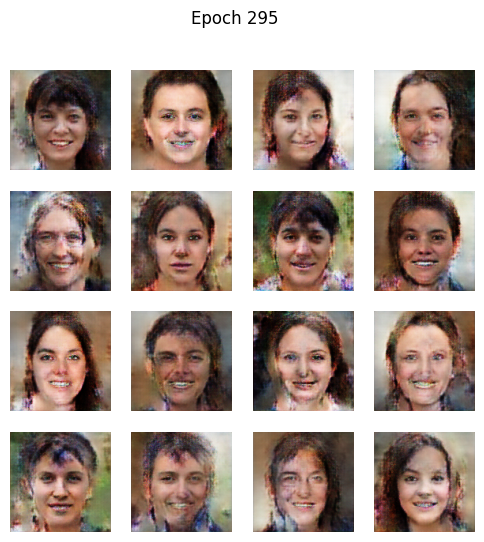

Epoch 296/400 | G: 1.568 D: 0.568
Epoch 297/400 | G: 2.236 D: 0.707
Epoch 298/400 | G: 1.555 D: 0.548
Epoch 299/400 | G: 2.135 D: 0.553
Epoch 300/400 | G: 1.072 D: 0.735


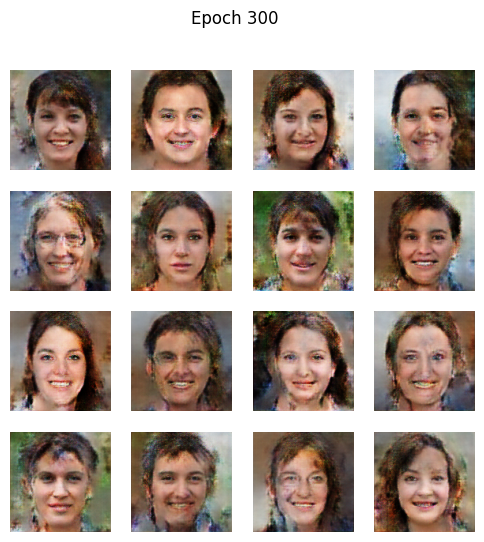

Epoch 301/400 | G: 1.364 D: 0.537
Epoch 302/400 | G: 1.518 D: 0.494
Epoch 303/400 | G: 3.694 D: 1.116
Epoch 304/400 | G: 2.553 D: 0.692
Epoch 305/400 | G: 1.404 D: 0.519


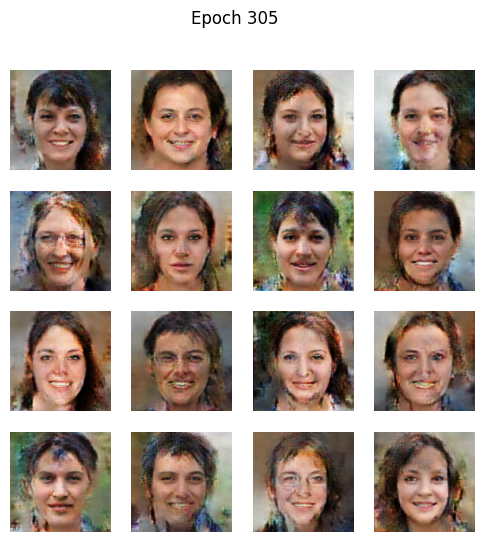

Epoch 306/400 | G: 1.983 D: 0.473
Epoch 307/400 | G: 2.182 D: 0.552
Epoch 308/400 | G: 1.188 D: 0.593
Epoch 309/400 | G: 1.516 D: 0.545
Epoch 310/400 | G: 2.531 D: 0.459


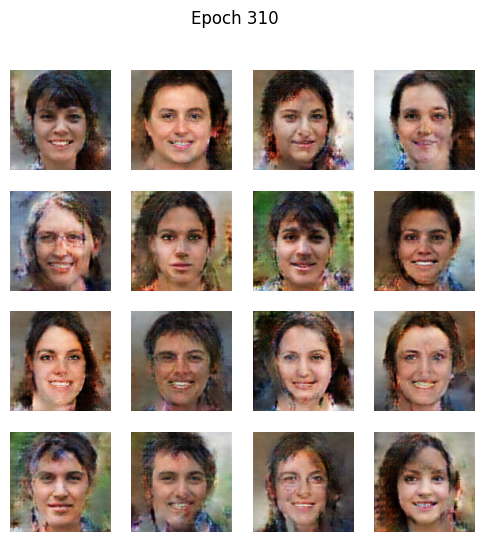

Epoch 311/400 | G: 2.337 D: 0.514
Epoch 312/400 | G: 1.161 D: 0.691
Epoch 313/400 | G: 1.342 D: 0.586
Epoch 314/400 | G: 1.815 D: 0.489
Epoch 315/400 | G: 0.388 D: 1.405


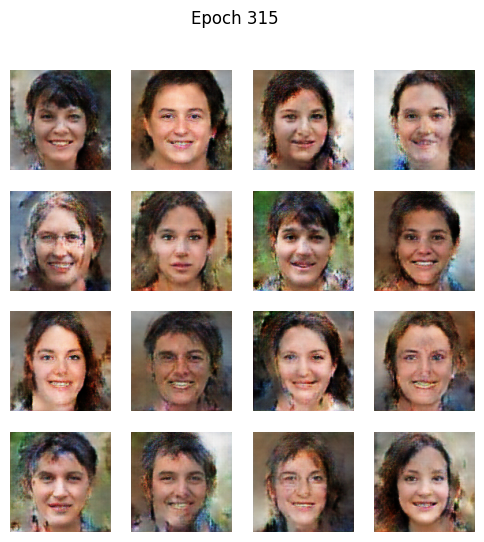

Epoch 316/400 | G: 1.033 D: 0.775
Epoch 317/400 | G: 1.989 D: 0.384
Epoch 318/400 | G: 0.840 D: 0.811
Epoch 319/400 | G: 1.380 D: 0.691
Epoch 320/400 | G: 1.748 D: 0.389


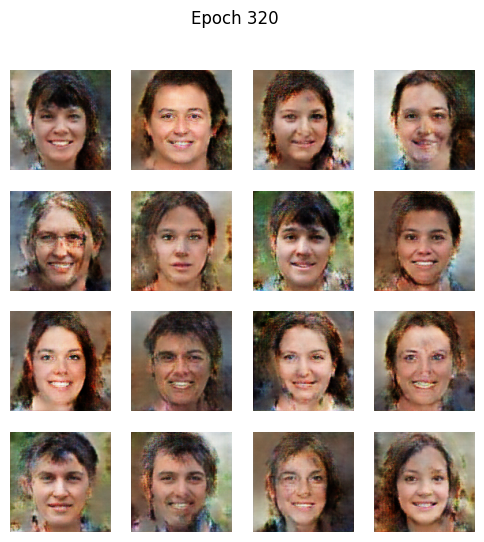

Epoch 321/400 | G: 1.592 D: 0.410
Epoch 322/400 | G: 1.664 D: 0.403
Epoch 323/400 | G: 1.098 D: 0.637
Epoch 324/400 | G: 2.470 D: 0.416
Epoch 325/400 | G: 1.134 D: 0.638


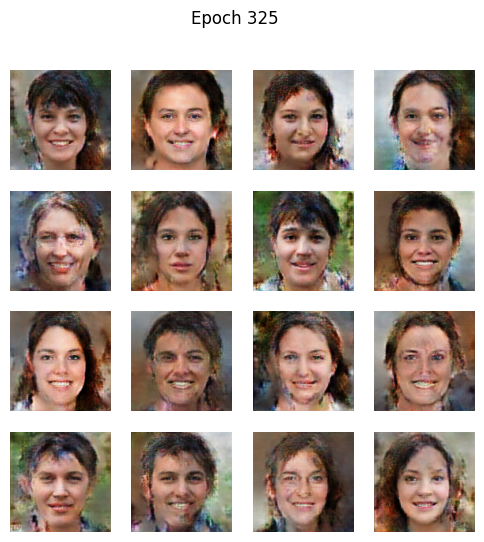

Epoch 326/400 | G: 2.378 D: 0.466
Epoch 327/400 | G: 1.071 D: 0.571
Epoch 328/400 | G: 0.949 D: 0.630
Epoch 329/400 | G: 2.844 D: 0.466
Epoch 330/400 | G: 1.739 D: 0.433


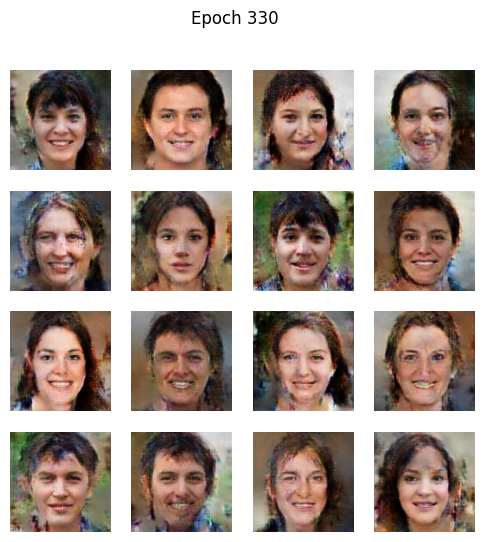

Epoch 331/400 | G: 1.891 D: 0.346
Epoch 332/400 | G: 2.037 D: 0.318
Epoch 333/400 | G: 3.560 D: 0.725
Epoch 334/400 | G: 1.982 D: 0.411
Epoch 335/400 | G: 0.547 D: 1.154


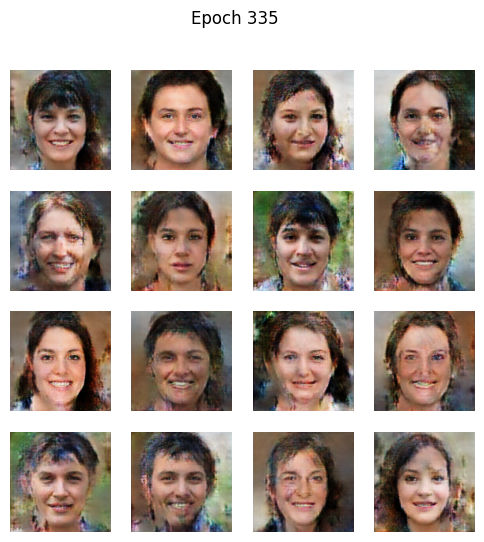

Epoch 336/400 | G: 3.713 D: 0.697
Epoch 337/400 | G: 2.902 D: 0.699
Epoch 338/400 | G: 2.302 D: 0.408
Epoch 339/400 | G: 1.392 D: 0.588
Epoch 340/400 | G: 1.346 D: 0.424


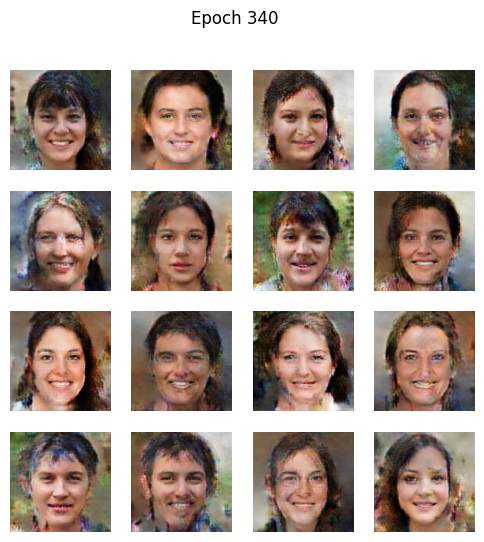

Epoch 341/400 | G: 1.385 D: 0.440
Epoch 342/400 | G: 1.442 D: 0.432
Epoch 343/400 | G: 2.810 D: 0.403
Epoch 344/400 | G: 1.865 D: 0.381
Epoch 345/400 | G: 3.974 D: 0.911


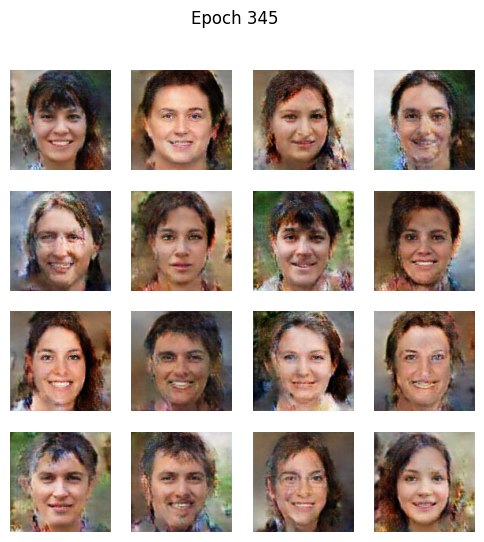

Epoch 346/400 | G: 0.953 D: 0.830
Epoch 347/400 | G: 1.380 D: 0.561
Epoch 348/400 | G: 0.667 D: 0.946
Epoch 349/400 | G: 2.439 D: 0.434
Epoch 350/400 | G: 2.281 D: 0.356


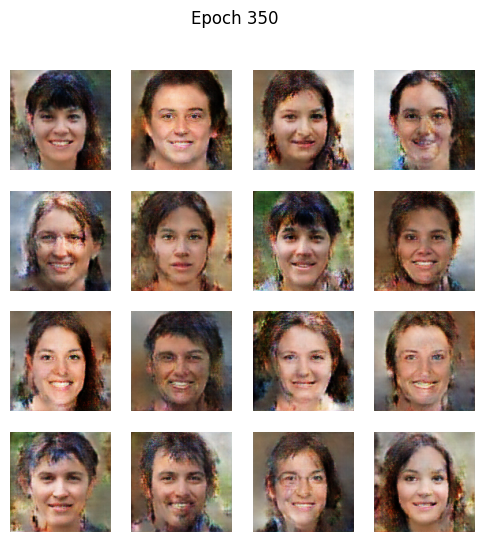

Epoch 351/400 | G: 1.847 D: 0.306
Epoch 352/400 | G: 1.687 D: 0.442
Epoch 353/400 | G: 2.313 D: 0.310
Epoch 354/400 | G: 1.835 D: 0.338
Epoch 355/400 | G: 1.804 D: 0.406


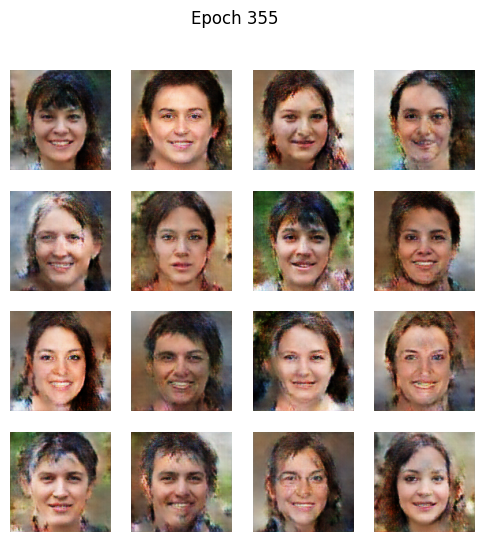

Epoch 356/400 | G: 4.843 D: 1.915
Epoch 357/400 | G: 2.359 D: 0.820
Epoch 358/400 | G: 2.147 D: 0.374
Epoch 359/400 | G: 1.734 D: 0.551
Epoch 360/400 | G: 2.117 D: 0.401


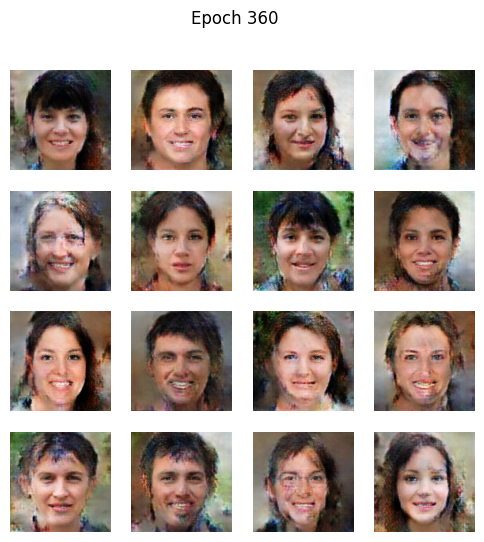

Epoch 361/400 | G: 1.585 D: 0.390
Epoch 362/400 | G: 2.286 D: 0.357
Epoch 363/400 | G: 2.395 D: 0.382
Epoch 364/400 | G: 2.845 D: 0.329
Epoch 365/400 | G: 1.335 D: 0.461


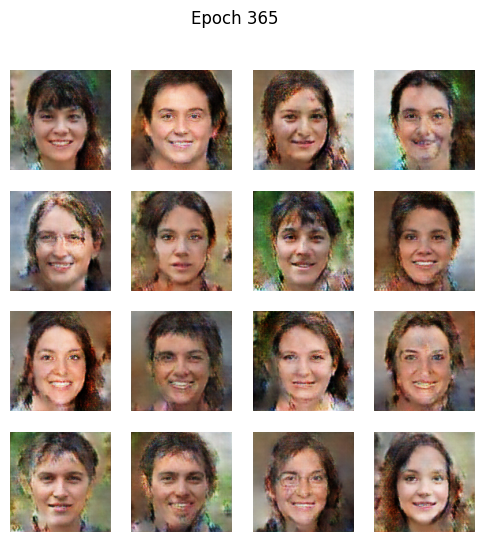

Epoch 366/400 | G: 2.429 D: 0.259
Epoch 367/400 | G: 1.329 D: 0.495
Epoch 368/400 | G: 2.772 D: 0.268
Epoch 369/400 | G: 2.327 D: 0.315
Epoch 370/400 | G: 2.575 D: 0.212


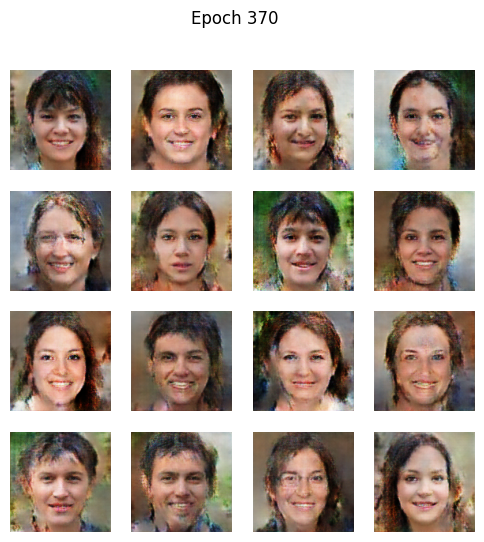

Epoch 371/400 | G: 2.121 D: 0.266
Epoch 372/400 | G: 1.768 D: 0.314
Epoch 373/400 | G: 3.922 D: 0.805
Epoch 374/400 | G: 0.188 D: 2.525
Epoch 375/400 | G: 2.191 D: 0.747


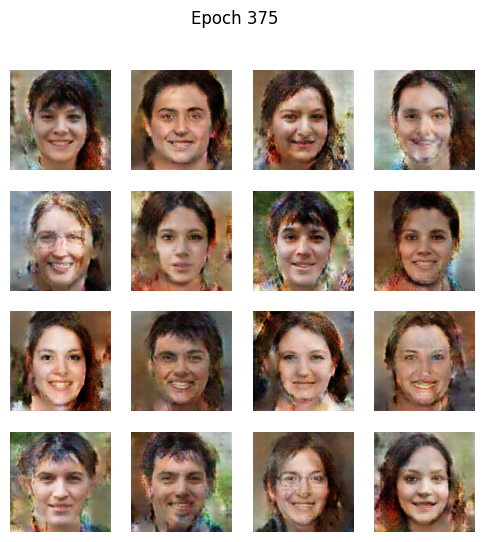

Epoch 376/400 | G: 2.393 D: 0.353
Epoch 377/400 | G: 2.713 D: 0.416
Epoch 378/400 | G: 2.064 D: 0.384
Epoch 379/400 | G: 2.478 D: 0.321
Epoch 380/400 | G: 2.189 D: 0.270


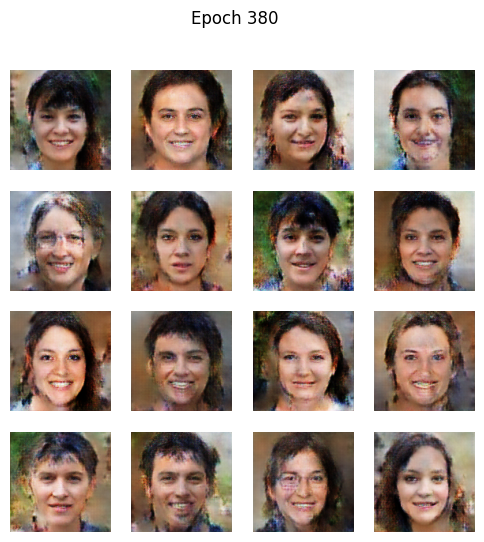

Epoch 381/400 | G: 0.635 D: 1.095
Epoch 382/400 | G: 1.761 D: 0.370
Epoch 383/400 | G: 2.216 D: 0.299
Epoch 384/400 | G: 2.417 D: 0.234
Epoch 385/400 | G: 2.703 D: 0.227


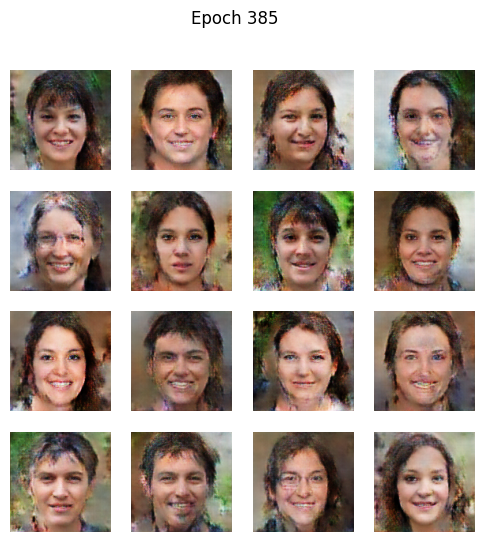

Epoch 386/400 | G: 2.585 D: 0.228
Epoch 387/400 | G: 2.466 D: 0.221
Epoch 388/400 | G: 2.540 D: 0.209
Epoch 389/400 | G: 2.331 D: 0.252
Epoch 390/400 | G: 3.041 D: 0.189


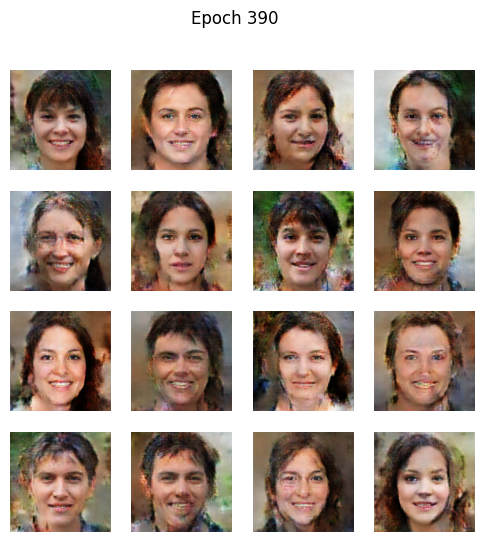

Epoch 391/400 | G: 2.781 D: 0.191
Epoch 392/400 | G: 4.531 D: 0.528
Epoch 393/400 | G: 1.902 D: 0.361
Epoch 394/400 | G: 2.428 D: 0.326
Epoch 395/400 | G: 2.341 D: 0.257


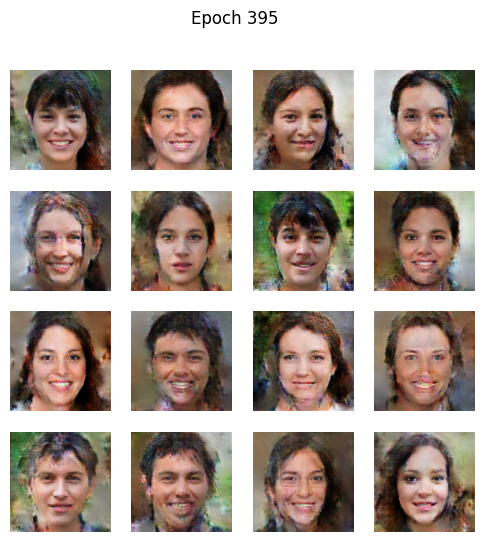

Epoch 396/400 | G: 3.138 D: 0.236
Epoch 397/400 | G: 3.650 D: 0.366
Epoch 398/400 | G: 1.337 D: 0.769
Epoch 399/400 | G: 3.683 D: 0.316
Epoch 400/400 | G: 2.682 D: 0.347


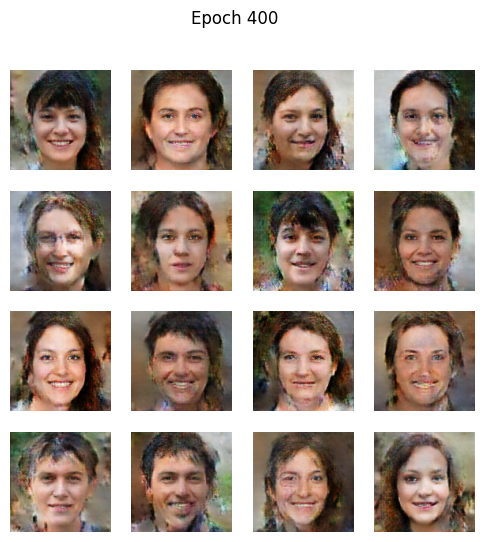

In [10]:
seed = tf.random.normal([16, LATENT_DIM])
for e in range(1, EPOCHS+1):
    for real in train_ds:
        g_loss, d_loss = train_step(real)
    print(f"Epoch {e}/{EPOCHS} | G: {g_loss:.3f} D: {d_loss:.3f}")
    if e % 5 == 0: show_images(e, seed)

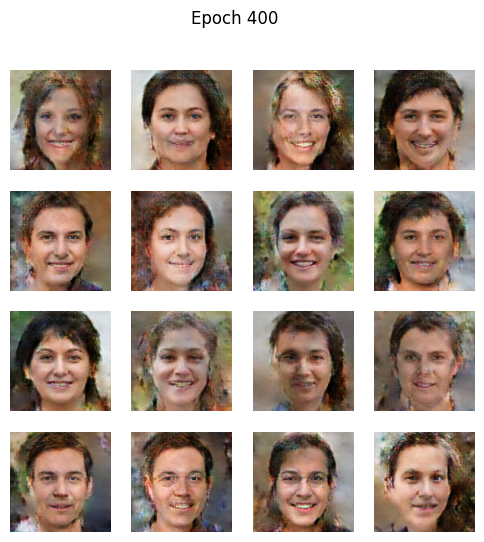

In [11]:
seed = tf.random.normal([16, LATENT_DIM])
show_images(e, seed)